# Libraries

In [2]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import cv2
import random
# from google.colab.patches import cv2_imshow
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

import os

In [7]:
# !curl -L "https://app.roboflow.com/ds/0Ywnnj8qWM?key=yuvI7oFWGb" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# Ckeck format of Dataset

In [5]:
DatasetCatalog.clear()
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "data/for_coco_v6/train/_annotations.coco.json", "data/for_coco_v6/train")
register_coco_instances("my_dataset_val", {}, "data/for_coco_v6/valid/_annotations.coco.json", "data/for_coco_v6/valid/")
register_coco_instances("my_dataset_test", {}, "data/for_coco_v6/test/_annotations.coco.json", "data/for_coco_v6/test")

In [4]:
# Verify that the COCO dataset has been loaded correctly
datasets = ["my_dataset_train", "my_dataset_val"]
for d in datasets:
    dataset_dicts = DatasetCatalog.get(d)
    for idx, d in enumerate(random.sample(dataset_dicts, 3)):
        print(f"Image {idx}: {d['file_name']}")



FileNotFoundError: [Errno 2] No such file or directory: 'data/for_coco_v6/train/_annotations.coco.json'

WARNING [05/21 10:12:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/21 10:12:19 d2.data.datasets.coco]: Loaded 1167 images in COCO format from data/for_coco_v6/train/_annotations.coco.json


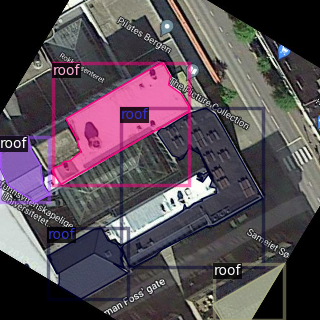

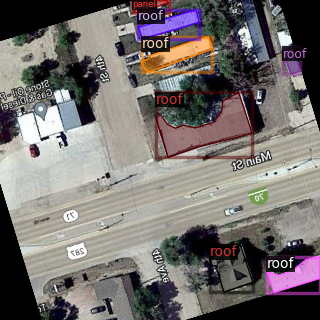

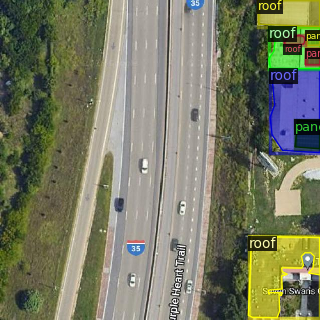

In [11]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [12]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [17]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001

cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 800 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


# cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.DATASETS.TRAIN = ("balloon_train",)
# cfg.DATASETS.TEST = ()
# cfg.DATALOADER.NUM_WORKERS = 2
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
# cfg.SOLVER.IMS_PER_BATCH = 2
# cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
# cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
# cfg.SOLVER.STEPS = []        # do not decay learning rate
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
# cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). 



In [18]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/21 10:18:20 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/21 10:18:22 d2.engine.train_loop]: Starting training from iteration 0
[05/21 10:19:10 d2.utils.events]:  eta: 0:30:17  iter: 19  total_loss: 2.308  loss_cls: 1.341  loss_box_reg: 0.6072  loss_rpn_cls: 0.3504  loss_rpn_loc: 0.03819    time: 2.3840  last_time: 2.5242  data_time: 0.0630  last_data_time: 0.0115   lr: 2.4726e-05  max_mem: 7264M
[05/21 10:19:59 d2.utils.events]:  eta: 0:31:47  iter: 39  total_loss: 2.182  loss_cls: 1.068  loss_box_reg: 0.7081  loss_rpn_cls: 0.2822  loss_rpn_loc: 0.04839    time: 2.4001  last_time: 2.5417  data_time: 0.0131  last_data_time: 0.0108   lr: 4.9701e-05  max_mem: 7264M
[05/21 10:20:48 d2.utils.events]:  eta: 0:31:09  iter: 59  total_loss: 1.822  loss_cls: 0.8752  loss_box_reg: 0.7877  loss_rpn_cls: 0.1216  loss_rpn_loc: 0.03966    time: 2.4157  last_time: 2.5383  data_time: 0.0147  last_data_time: 0.0261   lr: 7.4676e-05  max_mem: 7264M
[05/21 10:21:36 d2.utils.events]:  eta: 0:30:19  iter: 79  total_loss: 1.659  loss_cls: 0.712  loss_box_reg: 

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/21 10:38:27 d2.evaluation.evaluator]: Inference done 11/110. Dataloading: 0.0028 s/iter. Inference: 0.1864 s/iter. Eval: 0.0006 s/iter. Total: 0.1898 s/iter. ETA=0:00:18
[05/21 10:38:32 d2.evaluation.evaluator]: Inference done 38/110. Dataloading: 0.0037 s/iter. Inference: 0.1868 s/iter. Eval: 0.0005 s/iter. Total: 0.1912 s/iter. ETA=0:00:13
[05/21 10:38:37 d2.evaluation.evaluator]: Inference done 65/110. Dataloading: 0.0028 s/iter. Inference: 0.1869 s/iter. Eval: 0.0005 s/iter. Total: 0.1905 s/iter. ETA=0:00:08
[05/21 10:38:42 d2.evaluation.evaluator]: Inference done 92/110. Dataloading: 0.0032 s/iter. Inference: 0.1871 s/iter. Eval: 0.0005 s/iter. Total: 0.1909 s/iter. ETA=0:00:03
[05/21 10:38:46 d2.evaluation.evaluator]: Total inference time: 0:00:20.220910 (0.192580 s / iter per device, on 1 devices)
[05/21 10:38:46 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:19 (0.186933 s / iter per device, on 1 devices)
[05/21 10:38:46 d2.evaluation.coco_evaluation]: Pr

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/21 10:50:55 d2.evaluation.evaluator]: Inference done 11/110. Dataloading: 0.0013 s/iter. Inference: 0.1863 s/iter. Eval: 0.0005 s/iter. Total: 0.1881 s/iter. ETA=0:00:18
[05/21 10:51:00 d2.evaluation.evaluator]: Inference done 38/110. Dataloading: 0.0021 s/iter. Inference: 0.1855 s/iter. Eval: 0.0004 s/iter. Total: 0.1881 s/iter. ETA=0:00:13
[05/21 10:51:05 d2.evaluation.evaluator]: Inference done 64/110. Dataloading: 0.0025 s/iter. Inference: 0.1875 s/iter. Eval: 0.0005 s/iter. Total: 0.1907 s/iter. ETA=0:00:08
[05/21 10:51:11 d2.evaluation.evaluator]: Inference done 90/110. Dataloading: 0.0036 s/iter. Inference: 0.1892 s/iter. Eval: 0.0005 s/iter. Total: 0.1934 s/iter. ETA=0:00:03
[05/21 10:51:15 d2.evaluation.evaluator]: Total inference time: 0:00:20.424635 (0.194520 s / iter per device, on 1 devices)
[05/21 10:51:15 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:19 (0.189025 s / iter per device, on 1 devices)
[05/21 10:51:15 d2.evaluation.coco_evaluation]: Pr

In [33]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir=output/ --port=8008


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [34]:
%reload_ext tensorboard

# Inference & evaluation using the trained model

In [20]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/21 10:51:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [05/21 10:51:44 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/21 10:51:44 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/21 10:51:44 d2.data.datasets.coco]: Loaded 62 images in COCO format from data/for_coco_v6/test/_annotations.coco.json
[05/21 10:51:44 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| roof-panel | 0            |   panel    | 142          |    roof    | 247          |
|            |              |            |              |            |              |
|   total    | 389       

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/21 10:51:49 d2.evaluation.evaluator]: Inference done 11/62. Dataloading: 0.0099 s/iter. Inference: 0.2552 s/iter. Eval: 0.0006 s/iter. Total: 0.2657 s/iter. ETA=0:00:13
[05/21 10:51:54 d2.evaluation.evaluator]: Inference done 34/62. Dataloading: 0.0079 s/iter. Inference: 0.2249 s/iter. Eval: 0.0009 s/iter. Total: 0.2340 s/iter. ETA=0:00:06
[05/21 10:51:59 d2.evaluation.evaluator]: Inference done 58/62. Dataloading: 0.0064 s/iter. Inference: 0.2152 s/iter. Eval: 0.0009 s/iter. Total: 0.2230 s/iter. ETA=0:00:00
[05/21 10:52:00 d2.evaluation.evaluator]: Total inference time: 0:00:12.754321 (0.223760 s / iter per device, on 1 devices)
[05/21 10:52:00 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:12 (0.213277 s / iter per device, on 1 devices)
[05/21 10:52:00 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/21 10:52:00 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/21 10:52:01 d2.evaluation.coco_eva

OrderedDict([('bbox',
              {'AP': 34.05906169889267,
               'AP50': 55.45491857924611,
               'AP75': 34.991425577769675,
               'APs': 14.54870632520085,
               'APm': 38.78967652389222,
               'APl': 37.938817120877516,
               'AP-roof-panel': nan,
               'AP-panel': 28.000230285499246,
               'AP-roof': 40.11789311228608})])

In [ ]:
# %ls output

In [36]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[05/21 10:59:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


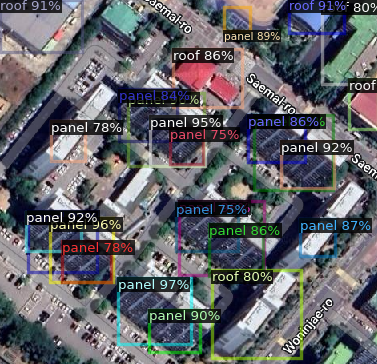

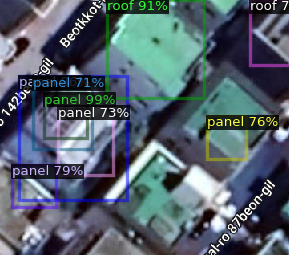

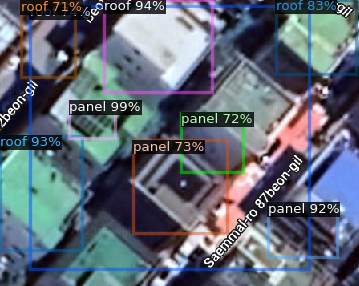

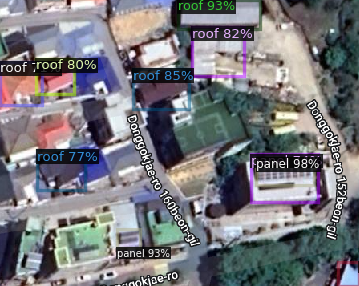

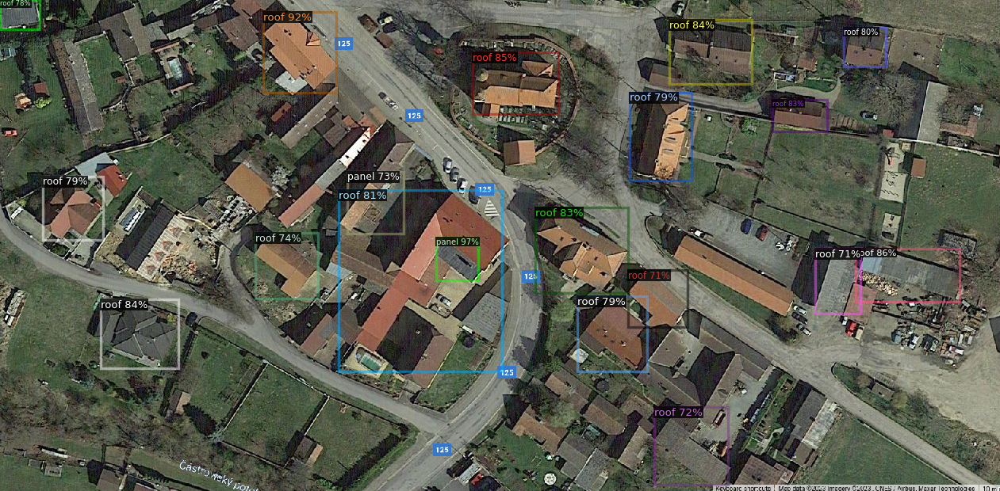

...

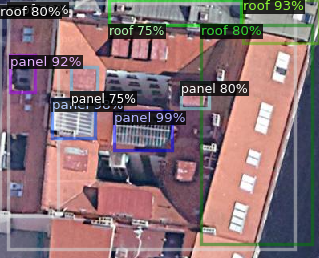

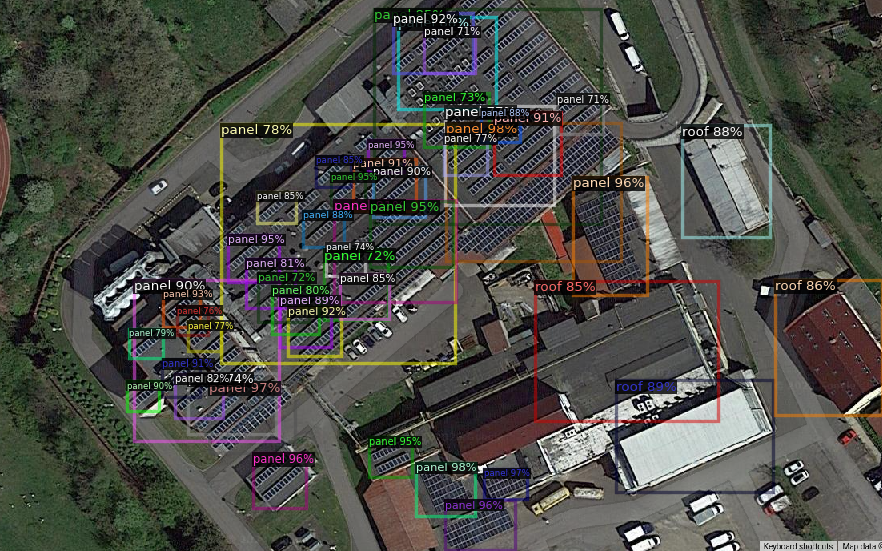

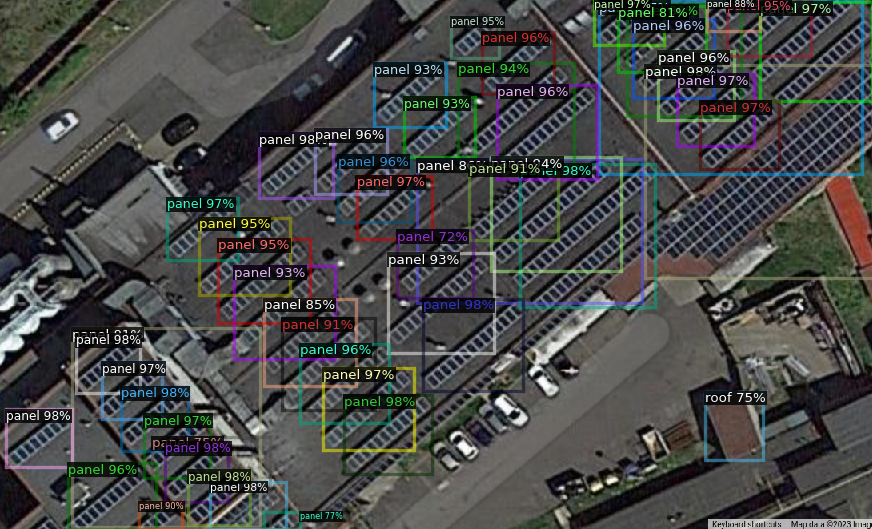

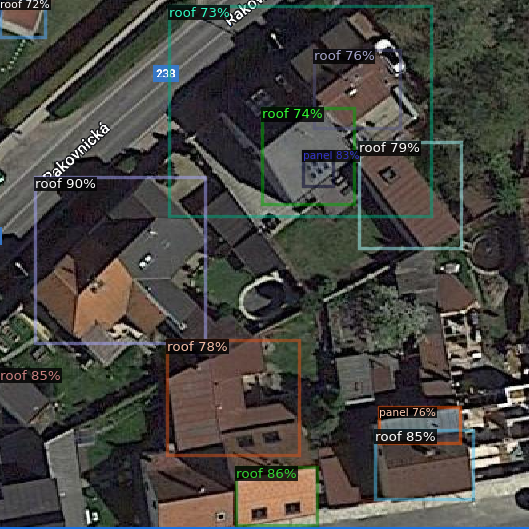

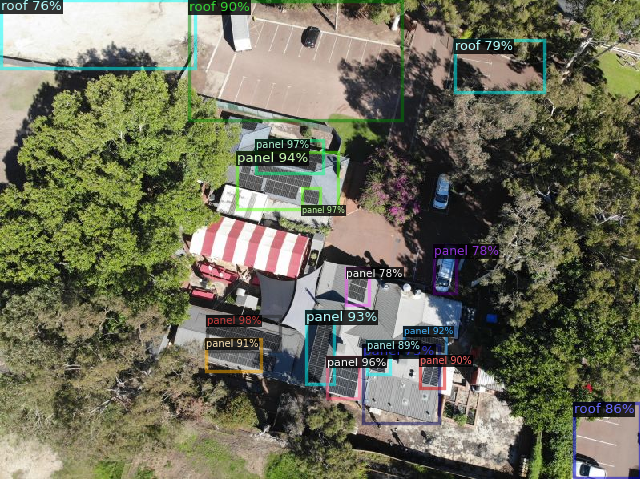

In [43]:
from detectron2.utils.visualizer import ColorMode
import glob
k= 0
for imageName in glob.glob('data/folder_for_test_pic/new/*'):
  k = k +1 
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  cv2.imwrite('/content/drive/MyDrive/Proactiveware/figure_results/result_of_fast_rcnn/{}.png'.format(k), out.get_image()[:, :, ::-1])

